# _Проектная работа №1_
# _по предмету "Основы математического моделирования"_
##  _Студента кафедры Общей физики и волновых процессов_
## _Моисеева Данилы, 325_
## _Вариант №17_

### _Постановка задачи_
Используя схему бегущего счета и итерационные методы, решить задачу для квазилинейного уравнения переноса:

$$\begin{equation}
 \left\{
\begin{aligned}
& \frac{\partial u}{\partial t} +2ue^{-u^2}\frac{\partial u}{\partial x}= 0,\qquad  0<x< 1 \\
& u(x,0)=sin{\frac{\pi x}2}\\
& u(0,t)=0
\end{aligned} \right. \label{eq1}
\end{equation} $$

### _Исследование характеристик_
Наша задача - квазилинейное уравнения переноса.
$$\frac{dt}{1}=\frac{dx}{2ue^{-u^2}}=\frac{du}{0} \Rightarrow u=Const,\qquad\frac{dx}{dt}=2ue^{-u^2}  $$



Импортируем необходимые библиотеки:

In [2]:
import numpy as np
from math import *
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objs as go
from matplotlib.animation import FuncAnimation

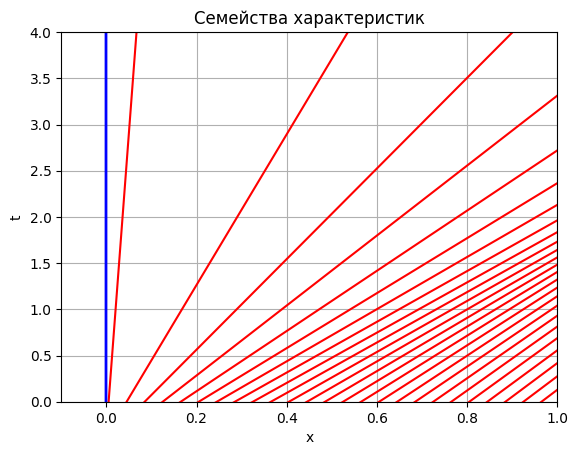

In [3]:
def char1(x):
    return [(exp(sin(pi*x0/2))**2/(2*sin(pi*x0/2))) * (x - x0) for x0 in np.arange(0.005, 1.1, 0.04)]

def char2(t):
    return [0  for t0 in np.arange(0, 1, 0.1)]

x_arr = np.arange(0, 1.1, 0.1)
t_arr = np.arange(0, 4.1, 0.1)

char1_arr = [char1(x) for x in x_arr]
char2_arr = [char2(t) for t in t_arr]

plt.subplot(1, 1, 1)
plt.ylim(0,4)
plt.xlim(-0.1,1)
plt.plot(x_arr, char1_arr, color='r') 
plt.plot(char2_arr, t_arr, color='b')
plt.title('Семейства характеристик')
plt.ylabel('t')
plt.xlabel('x')
plt.grid(True)


при $t_0=0$: $t=\frac{x-x_0}{2sin{\frac{\pi x_0}2}}e^{-sin{\frac{\pi x_0}2}^2}$ - являются прямыми, изображены на рисунке <span style="color:red"> красным </span>.

при $x_0=0$: $x=0$ - изображено <span style="color:blue"> синим </span>.

при  $x_0=t_0=0$: $x=0$ - прямая, разделяющая два семейства решений.

**_Таким образом, в заданной области характеристики не пересекаются, а значит, решение единственно._**

## *Численное решение*

### *Метод решения*
Для решения нашей задачи будем пользоваться **методом конечных разностей**. 
$$\frac{\partial u}{\partial t} +2ue^{-u^2}\frac{\partial u}{\partial x}= 0$$
$$\frac{\partial u}{\partial t} +\frac{\partial }{\partial x}\bigg(-e^{-u^2}\bigg)= 0 \Rightarrow F=-e^{-u^2}$$


### *Построение разностной схемы В*
Введем в расчетной области равномерную сетку:
$$\overline{\omega_{h,\tau}}=\big\{x_n=nh, t_m=m\tau, n=\overline{0,H-1}, m=\overline{0,Tau-1}\big\}$$
где $h,\tau$- шаги по координате и времени соответственно, $H,Tau$ - число узлов по осям $x,t$ соответственно.

Введем на $\overline{\omega_{h,\tau}}$ сеточную функцию: $y_n^m=u(x_n,t_m)$.

В нашей задаче для построения разностной схемы будем пользоваться **трехточечным шаблоном**, поскольку для линейного уравнения переноса он является **безусловно устойчивым**, а разностный оператор аппроксимирует дифференциальный с **первым порядком точности** $O(h+\tau)$. 

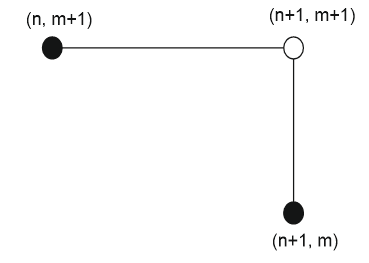

Таким образом, **разностная задача**, аппроксимирующая исходную задачу в точке $(x_{n+1},t_{m+1})$ , имеет следующий вид:

$$\begin{equation}
 \left\{
\begin{aligned}
&\frac{u_{n+1}^{m+1}-u_{n+1}^{m}}{\tau}+\frac{F_{n+1}^{m+1}-F_{n}^{m+1}}{h}=0,\\
& u_n^0=sin{\frac{\pi x_n}2},  n=\overline{0,H-1}\\
& y_0^m=0, m=\overline{0,Tau-1}
\end{aligned} \right. \label{eq4}
\end{equation} $$

Это неявное уравнение относительно $ u^{m+1}_{n+1} $. Будем решать его [итерационным методом Ньютона](https://ru.wikipedia.org/wiki/%D0%9C%D0%B5%D1%82%D0%BE%D0%B4_%D0%9D%D1%8C%D1%8E%D1%82%D0%BE%D0%BD%D0%B0).

$$ {u^{m+1}_{n+1}}^{(s+1)} = {u^{m+1}_{n+1}}^{(s)} - \frac{ f({u^{m+1}_{n+1}}^{(s)}) }  { f'({u^{m+1}_{n+1}}^{(s)}) } $$
$$ f(u^{(s)}) =  \frac{u^{(s)}-u_{n+1}^{m}}{\tau}+\frac{F(u^{(s)})-F(u_{n}^{m+1})}{h}$$
$$ f'(u^{(s)}) = \frac{1}{\tau}+\frac{2u^{(s)}e^{-{u^{(s)}}^2}}{h} $$

До достижения заданной точности $ \epsilon $: $$ | {u^{m+1}_{n+1}}^{(s+1)} - {u^{m+1}_{n+1}}^{(s)} | \leq \epsilon $$

###  *Исследование задачи на устойчивость* 
Поскольку в данной задаче скорость переноса $c(x,t)=2t$ зависит от времени, будем пользоваться **спектральным критерием Неймана с "замороженными" коэффициентами**.

Рассмотрим произвольную точку $(x^*,t^*)\in\overline{ \omega_{h,\tau}}$ и положим $c(x^*,t^*)=C$

Тогда, проанализируем однородное линейное уравнение переноса:
$$\frac{\partial u}{\partial t}+C\frac{\partial u}{\partial t}=0 \Rightarrow \frac{y_n^{j+1}-y_n^{j}}{\tau}+C\frac{y_n^{j+1}-y_{n-1}^{j+1}}{h}=0$$

где начальные условия имееют специальный вид: $y_n^0=e^{iqx_n}=e^{i\alpha n}$, $\alpha=qh$, $q$ - произвольное вещественное число. 

Тогда, подставляя в полученное уравнение значение $y_n^0$, получим, что  $y_n^1=\lambda e^{i\alpha n} $, и так далее, на произвольном $j$  слое получим: $y_n^j=\lambda^{j}e^{i\alpha n}$. 

Числа $\lambda$ называются множителями роста.

Подставим $y_n^j=\lambda^{j}e^{i\alpha n}$ в уравнение:
$$\frac{\lambda ^{j+1}e^{i\alpha n} -\lambda ^{j}e^{i\alpha n}}{\tau}-C\frac{\lambda ^{j+1}e^{i\alpha n} -\lambda ^{j+1}e^{i\alpha n}e^{-i\alpha}}{h}=0  $$
$$\frac{1-\frac{1}{\lambda}}{\tau}+C\frac{1-e^{-i \alpha}}{h}=0$$
Тогда: $$\lambda=\frac{1}{1+\frac{C\tau}{h}(1-e^{-i\alpha})}$$
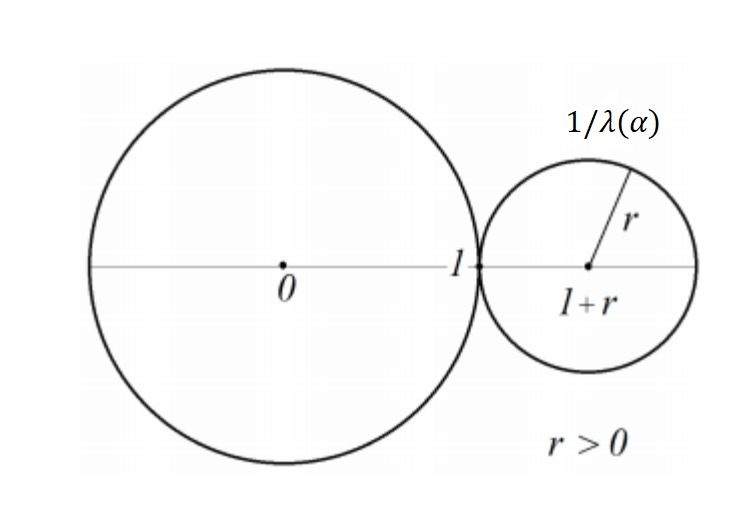
Рассмотрим $|\lambda ^{-1}|= 1+\frac{C\tau}{h}(1-e^{-i\alpha})$  и положим $r=\frac{C\tau}{h}$. Тогда спектр значений $\lambda^{-1}$ при любых вещественных $\alpha$ представляет окружность с центром в точке $1+r$ и радиусом $r$. Поскольку в нашем случае $С>0$, то и $r>0$. Значит, окружность, заполняемая значениями $\lambda^{-1}$ расположена вне единичного круга с центром в начале координат и касается окружности единичного радиуса. 

Это значит, что $|\lambda ^{-1}|\geq1 \Rightarrow |\lambda|\leq1$, и выбранная схема является **безусловно устойчивой** при любых соотношениях между $h$ и $\tau$.

In [4]:
def F(u,i,j):
    return -exp(-u[i][j] ** 2)
def F2(u,i,j):
    return -exp(-u2[i][j] ** 2)
def F3(u,i,j):
    return -exp(-u3[i][j] ** 2)

In [5]:
H = 100
Tau = 500
eps = 10 ** (-6)
h = 1/H
tau = 5/Tau
u = np.zeros(H * Tau).reshape(H, Tau)
for x in range(H):
    u[x][0] = sin(pi*(x*h)/2)
for n in range(H-1):
    for m in range(Tau-1): 
        un1 = u[n][m]
        un2 = u[n][m] + 2*eps
        while abs(un1 - un2) > eps:
            f = (un2- u[n+1][m])/tau + (-exp(-un2**2) - F(u, n, m+1))/h
            df = 1/tau + 2*un2*exp(-un2**2)/h
            un1 = un2
            un2 = un2 - f/df
        u[n+1][m+1] = un2

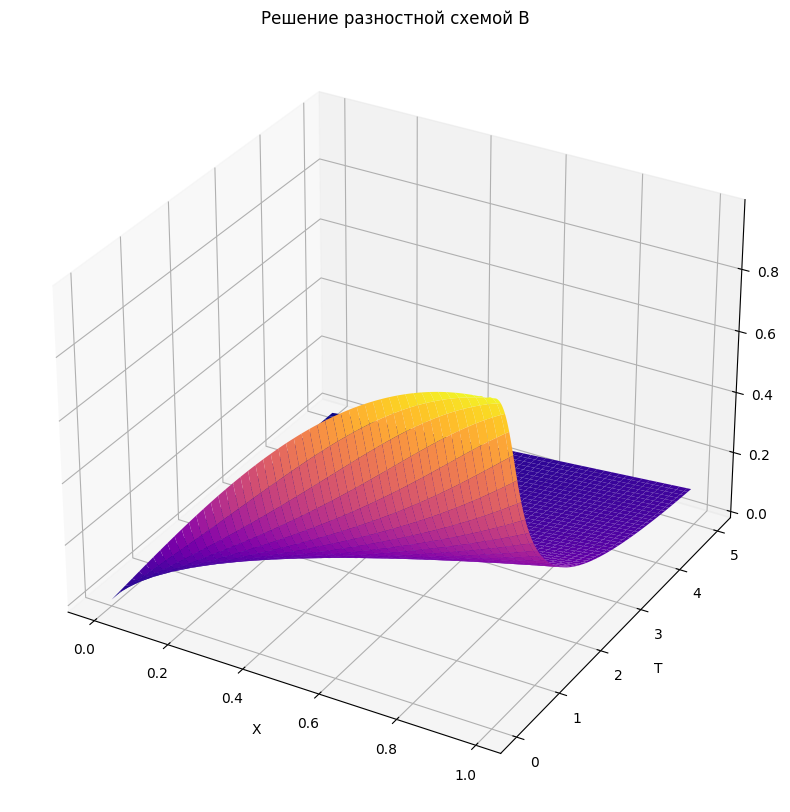

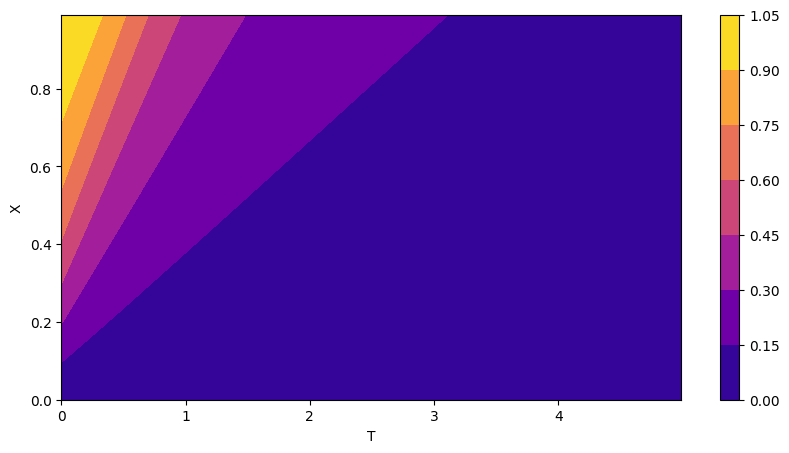

In [12]:
x = np.arange(0, H)*h
t = np.arange(0, Tau)*tau
T, X = np.meshgrid(t, x)


fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot( projection = '3d',title='Решение разностной схемой В')
ax.plot_surface(X, T, u,cmap= 'plasma')
ax.set_xlabel('X')
ax.set_ylabel('T')
ax.set_zlabel('U')
plt.show()
# data = [go.Surface(x = X, y = T, z = u, colorscale = 'YlGnBu')]
# fig = go.Figure(data = data)
# fig.update_layout(title='Решение разностной схемой В', autosize=False,
#                   width=800, height=800,
                  
#                   scene=dict(
#         xaxis_title='X',
#         yaxis_title='T',
#         zaxis_title='U',
#     ),)
# plotly.offline.iplot(fig)


fig = plt.figure(figsize=(10, 5))
plt.contourf( t,x, u, cmap= 'plasma')
plt.colorbar()
plt.xlabel('T')
plt.ylabel('X')
plt.show()

### *Решение другой разностной схемой А*

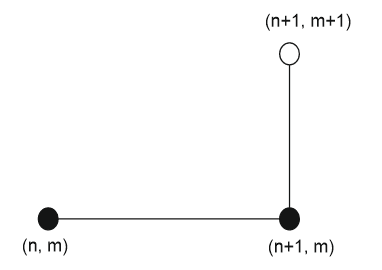

Таким образом, **разностная задача**, аппроксимирующая исходную задачу в точке $(x_{n+1},t_{m+1})$ , имеет следующий вид:

$$\begin{equation}
 \left\{
\begin{aligned}
&\frac{u_{n+1}^{m+1}-u_{n+1}^{m}}{\tau}+\frac{F_{n+1}^{m}-F_{n}^{m}}{h}=0,\\
& u_n^0=sin{\frac{\pi x_n}2},  n=\overline{0,H-1}\\
& y_0^m=0, m=\overline{0,Tau-1}
\end{aligned} \right. \label{eq4}
\end{equation} $$

Это неявное уравнение относительно $ u^{m+1}_{n+1} $. Будем решать его [итерационным методом Ньютона](https://ru.wikipedia.org/wiki/%D0%9C%D0%B5%D1%82%D0%BE%D0%B4_%D0%9D%D1%8C%D1%8E%D1%82%D0%BE%D0%BD%D0%B0).

$$ {u^{m+1}_{n+1}}^{(s+1)} = {u^{m+1}_{n+1}}^{(s)} - \frac{ f({u^{m+1}_{n+1}}^{(s)}) }  { f'({u^{m+1}_{n+1}}^{(s)}) } $$
$$ f(u^{(s)}) =  \frac{u^{(s)}-u_{n+1}^{m}}{\tau}+\frac{F(u_{n+1}^{m})-F(u_{n}^{m})}{h}$$
$$ f'(u^{(s)}) = \frac{1}{\tau} $$

До достижения заданной точности $ \epsilon $: $$ | {u^{m+1}_{n+1}}^{(s+1)} - {u^{m+1}_{n+1}}^{(s)} | \leq \epsilon $$

In [13]:
H = 100
Tau = 500
eps = 10 ** (-6)
h = 1/H
tau = 5/Tau
u2 = np.zeros(H * Tau).reshape(H, Tau)
for x in range(H):
    u2[x][0] = sin(pi*(x*h)/2)
for n in range(H-1):
    for m in range(Tau-1): 
        un1 = u2[n][m]
        un2 = u2[n][m] + 2*eps
        while abs(un1 - un2) > eps:
            f = (un2- u2[n+1][m])/tau + (F2(u, n+1, m) - F2(u, n, m))/h
            df = 1/tau
            un1 = un2
            un2 = un2 - f/df
        u2[n+1][m+1] = un2

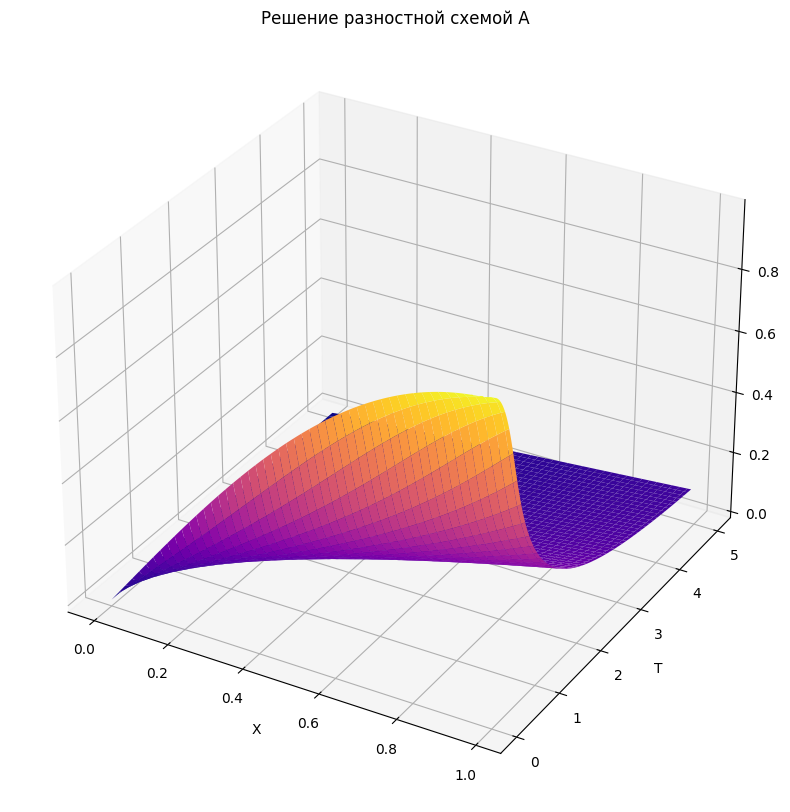

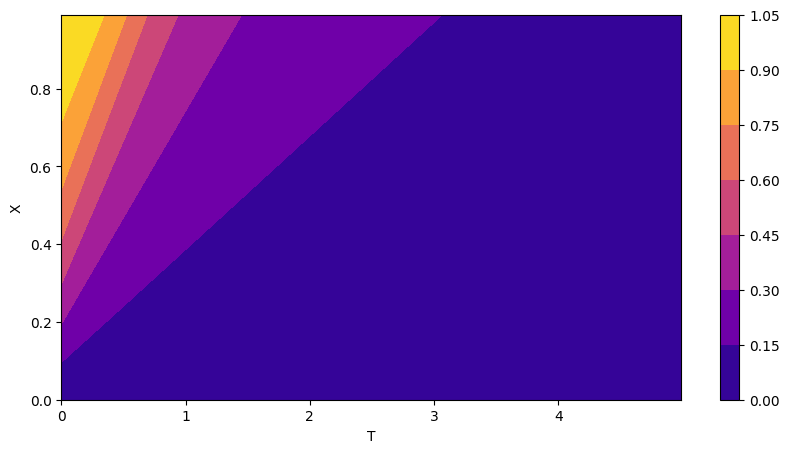

In [17]:
x = np.arange(0, H)*h
t = np.arange(0, Tau)*tau
T, X = np.meshgrid(t, x)

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot( projection = '3d',title='Решение разностной схемой A')
ax.plot_surface(X, T, u2,cmap= 'plasma')
ax.set_xlabel('X')
ax.set_ylabel('T')
ax.set_zlabel('U')
plt.show()

# data = [go.Surface(x = X, y = T, z = u2, colorscale = 'YlGnBu')]
# fig = go.Figure(data = data)
# fig.update_layout(title='Решение разностной схемой A', autosize=False,
#                   width=800, height=800,
                  
#                   scene=dict(
#         xaxis_title='X',
#         yaxis_title='T',
#         zaxis_title='U',
#     ),)
# plotly.offline.iplot(fig)


fig = plt.figure(figsize=(10, 5))
plt.contourf( t,x, u2, cmap= 'plasma')
plt.colorbar()
plt.xlabel('T')
plt.ylabel('X')
plt.show()

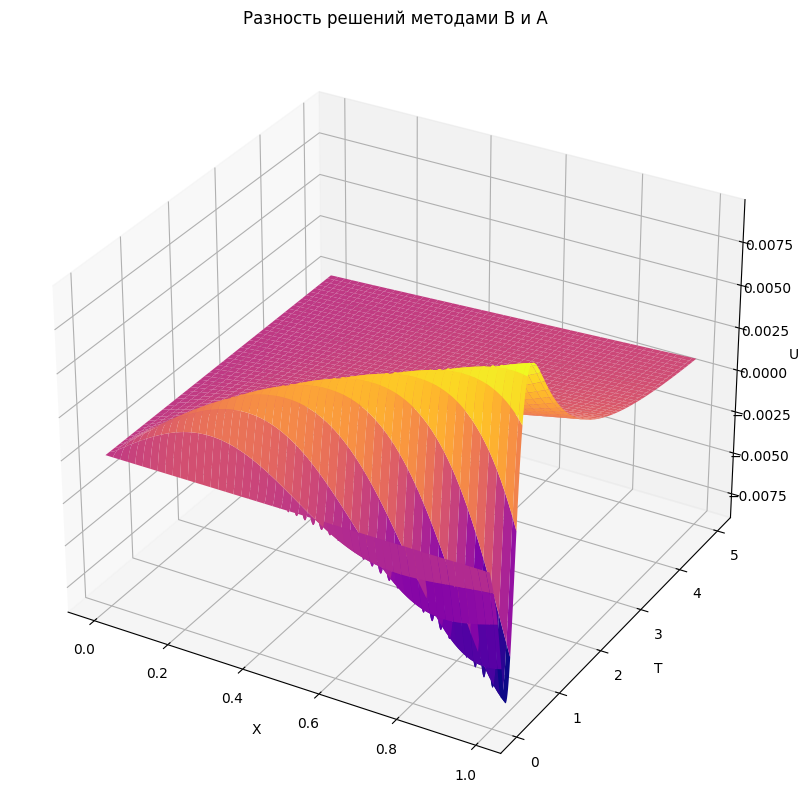

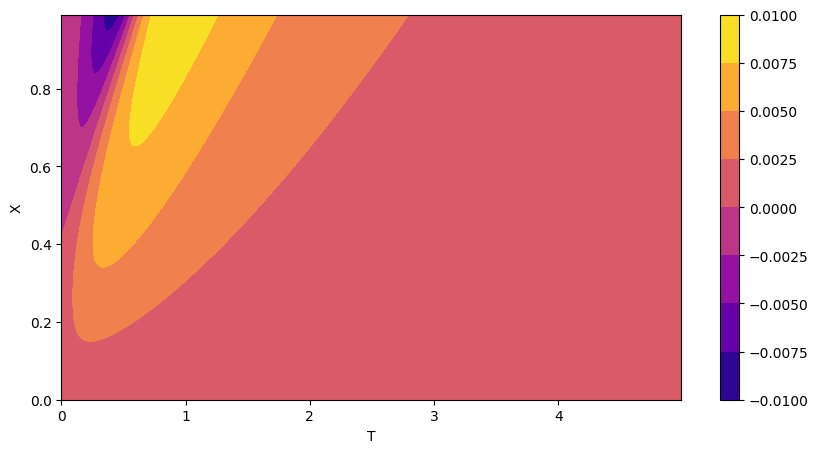

In [16]:
x = np.arange(0, H)*h
t = np.arange(0, Tau)*tau
T, X = np.meshgrid(t, x)

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot( projection = '3d',title='Разность решений методами В и А')
ax.plot_surface(X, T, u-u2,cmap= 'plasma')
ax.set_xlabel('X')
ax.set_ylabel('T')
ax.set_zlabel('U')
plt.show()

# data = [go.Surface(x = X, y = T, z = u-u2, colorscale = 'YlGnBu')]
# fig = go.Figure(data = data)
# fig.update_layout(title='Разность решений методами В и А', autosize=False,
#                   width=800, height=800,
                 
#                   scene=dict(
#         xaxis_title='X',
#         yaxis_title='T',
#         zaxis_title='ΔU',
#     ),)
# plotly.offline.iplot(fig)


fig = plt.figure(figsize=(10, 5))
plt.contourf( t,x, u-u2, cmap= 'plasma')
plt.colorbar()
plt.xlabel('T')
plt.ylabel('X')
plt.show()

In [18]:
fig, ax = plt.subplots(figsize=(8, 6))
xdata, ydata = [], []
ln, = plt.plot([], [], )
textvar = fig.text(0.15, 0.15, '', fontsize = 20)

def init():
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    return ln,

def update(frame):
    # print('frame',frame)
    xdata = x
    ydata = u[:,int(frame)]
    # print(ydata)
    # print(xdata)
    textvar.set_text(f't = {round(frame*tau, 2)}')
    ln.set_data(list(xdata), list(ydata))
    return ln,

animation = FuncAnimation(fig, update, frames=range(0, np.shape(u)[1]), init_func=init,)


from IPython.display import HTML, display
display(HTML(animation.to_jshtml()))
plt.close(fig)

### *Решение другой разностной схемой Г*

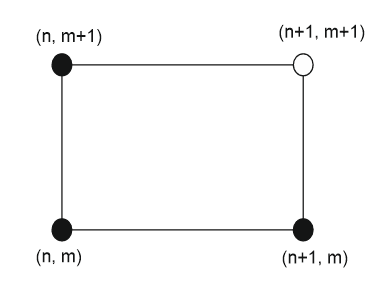

Таким образом, **разностная задача**, аппроксимирующая исходную задачу в точке $(x_{n+1},t_{m+1})$ , имеет следующий вид:

$$\begin{equation}
 \left\{
\begin{aligned}
&\frac{u_{n}^{m+1}-u_{n}^{m} + u^{(s)}-u_{n+1}^{m}}{2\tau}+\frac{F_{n+1}^{m}-F_{n}^{m} + F(u^{(s)})-F_{n+1}^{m+1}}{2h}=0,\\
& u_n^0=sin{\frac{\pi x_n}2},  n=\overline{0,H-1}\\
& y_0^m=0, m=\overline{0,Tau-1}
\end{aligned} \right. \label{eq4}
\end{equation} $$

Это неявное уравнение относительно $ u^{m+1}_{n+1} $. Будем решать его [итерационным методом Ньютона](https://ru.wikipedia.org/wiki/%D0%9C%D0%B5%D1%82%D0%BE%D0%B4_%D0%9D%D1%8C%D1%8E%D1%82%D0%BE%D0%BD%D0%B0).

$$ {u^{m+1}_{n+1}}^{(s+1)} = {u^{m+1}_{n+1}}^{(s)} - \frac{ f({u^{m+1}_{n+1}}^{(s)}) }  { f'({u^{m+1}_{n+1}}^{(s)}) } $$
$$ f(u^{(s)}) =  \frac{u_{n}^{m+1}-u_{n}^{m} + u^{(s)}-u_{n+1}^{m}}{2\tau}+\frac{F_{n+1}^{m}-F_{n}^{m} + F(u^{(s)})-F_{n+1}^{m+1}}{2h}$$
$$ f'(u^{(s)}) = \frac{1}{2\tau}+\frac{2u^{(s)}e^{-{u^{(s)}}^2}}{2h}$$

До достижения заданной точности $ \epsilon $: $$ | {u^{m+1}_{n+1}}^{(s+1)} - {u^{m+1}_{n+1}}^{(s)} | \leq \epsilon $$

In [19]:
H = 100
Tau = 500
eps = 10 ** (-9)
h = 1/H
tau = 5/Tau
u3 = np.zeros(H * Tau).reshape(H, Tau)
for x in range(H):
    u3[x][0] = sin(pi*(x*h)/2)
for n in range(H-1):
    for m in range(Tau-1): 
        un1 = u3[n][m]
        un2 = u3[n][m] + 2*eps
        while abs(un1 - un2) > eps:
            f = (u3[n][m+1] - u3[n][m] + un2- u3[n+1][m])/(2*tau) + (F3(u, n+1, m) - F3(u, n, m) -exp(-un2**2) -F3(u, n, m+1) )/(2*h)
            df = 1/(2*tau) + 2*un2*exp(-un2**2)/(2*h)
            un1 = un2
            un2 = un2 - f/df
        u3[n+1][m+1] = un2

In [20]:
s = 0
for n in range(H-1):
    for m in range(Tau-1): 
        if u[n][m] != 0:
            d = (u[n][m]-u3[n][m])
            if s < d:
                s = d
                i = n
                j = m
            
print(s, i*h , j* tau)

0.008718252201303733 0.98 0.91


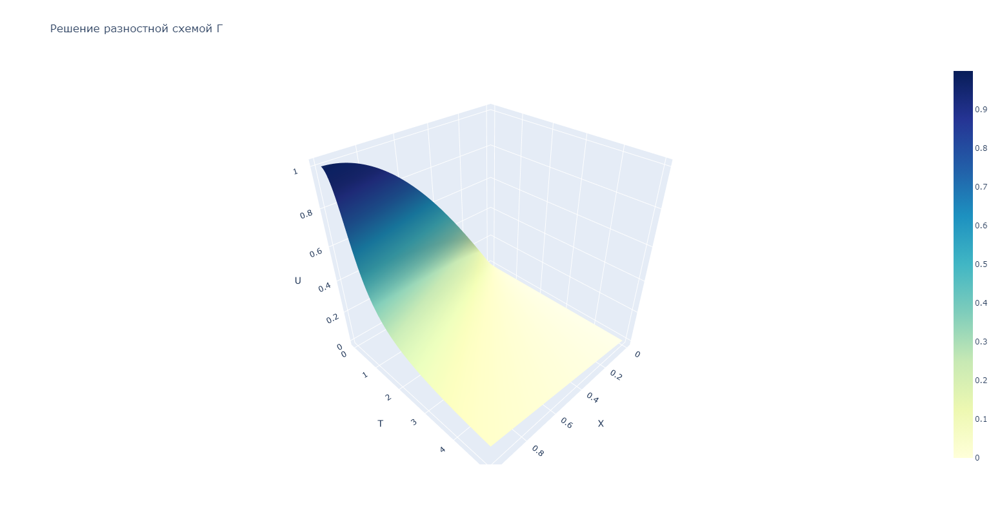

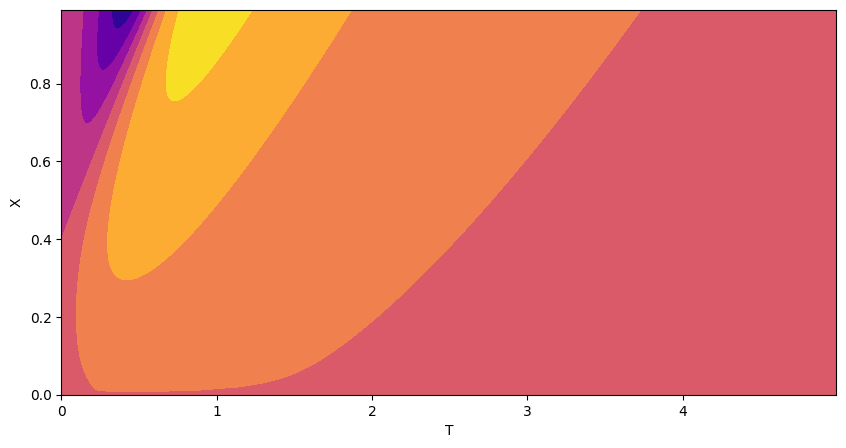

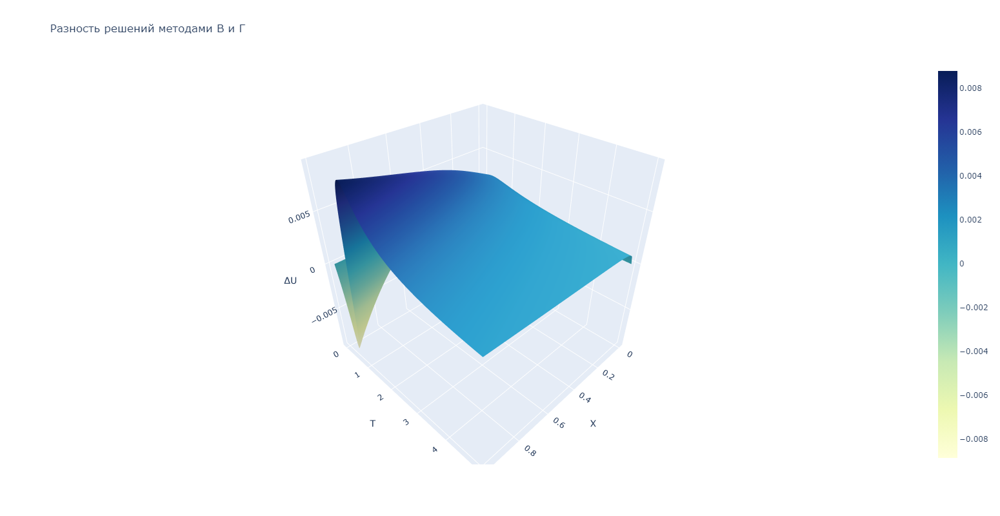

In [17]:
x = np.arange(0, H)*h
t = np.arange(0, Tau)*tau
T, X = np.meshgrid(t, x)

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot( projection = '3d',title='Решение разностной схемой Г')
ax.plot_surface(X, T, u3,cmap= 'plasma')
ax.set_xlabel('X')
ax.set_ylabel('T')
ax.set_zlabel('U')
plt.show()
# data = [go.Surface(x = X, y = T, z = u3, colorscale = 'YlGnBu')]
# fig = go.Figure(data = data)
# fig.update_layout(title='Решение разностной схемой Г', autosize=False,
#                   width=800, height=800,
                 
#                   scene=dict(
#         xaxis_title='X',
#         yaxis_title='T',
#         zaxis_title='U',
#     ),)
# plotly.offline.iplot(fig, filename ="32")

fig = plt.figure(figsize=(10, 5))
plt.contourf( t,x, u-u3, cmap= 'plasma')

plt.xlabel('T')
plt.ylabel('X')

plt.show()

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot( projection = '3d',title='Разность решений методами В и Г')
ax.plot_surface(X, T, u-u3,cmap= 'plasma')
ax.set_xlabel('X')
ax.set_ylabel('T')
ax.set_zlabel('U')
plt.show()
# data = [go.Surface(x = X, y = T, z = u-u3, colorscale = 'YlGnBu')]
# fig = go.Figure(data = data)
# fig.update_layout(title='Разность решений методами В и Г', autosize=False,
#                   width=800, height=800,
                 
#                   scene=dict(
#         xaxis_title='X',
#         yaxis_title='T',
#         zaxis_title='ΔU',
#     ),)
# plotly.offline.iplot(fig)

# Вывод #
### Данное уравнение решено тремя разными разностными схемами. Отклонения в решениях состовляют не более 0.009 ###